## Inference & Validation

After training completes, use this code to test your model!

In [ ]:
print("="*80)
print("SDXL NARUTO LORA - INFERENCE & COMPARISON")
print("="*80)
print("\n📦 Installing dependencies...")

!pip install diffusers==0.30.3 transformers==4.44.2 accelerate peft safetensors pillow -q

print("✓ Dependencies installed")

SDXL NARUTO LORA - INFERENCE & COMPARISON

📦 Installing dependencies...
✓ Dependencies installed


In [ ]:
import torch
from diffusers import StableDiffusionXLPipeline, DPMSolverMultistepScheduler
from peft import PeftModel
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import display
import os

print("\n✓ Libraries imported")
print(f"✓ PyTorch version: {torch.__version__}")
print(f"✓ CUDA available: {torch.cuda.is_available()}")

if torch.cuda.is_available():
    print(f"✓ GPU: {torch.cuda.get_device_name(0)}")
    vram_gb = torch.cuda.get_device_properties(0).total_memory / 1e9
    print(f"✓ VRAM: {vram_gb:.2f} GB")

from google.colab import drive
drive.mount('/content/drive')

print("✓ Google Drive mounted")


✓ Libraries imported
✓ PyTorch version: 2.8.0+cu126
✓ CUDA available: True
✓ GPU: Tesla T4
✓ VRAM: 15.83 GB
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✓ Google Drive mounted


## Configuration

In [ ]:
class InferenceConfig:
    """Configuration for inference"""

    # Model paths
    base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
    lora_weights_path = "/content/drive/MyDrive/sdxl-naruto-lora/final_lora"

    # Output directory
    output_dir = "/content/inference_results"

    # Generation parameters
    num_inference_steps = 30  # Number of denoising steps
    guidance_scale = 7.5  # How closely to follow the prompt (5-15 range)
    num_images_per_prompt = 1  # Generate 1 image per prompt

    # Test prompts
    test_prompts = [
        "Naruto Uzumaki eating ramen",
        "Bill Gates in Naruto style",
        "A boy with blue eyes in Naruto style",
    ]

    # Image settings
    height = 1024
    width = 1024
    seed = 42  # For reproducibility

config = InferenceConfig()

# Create output directory
os.makedirs(config.output_dir, exist_ok=True)

print("✓ Configuration loaded")
print(f"\n📁 LoRA weights: {config.lora_weights_path}")
print(f"📁 Output directory: {config.output_dir}")
print(f"📊 Test prompts: {len(config.test_prompts)}")

✓ Configuration loaded

📁 LoRA weights: /content/drive/MyDrive/sdxl-naruto-lora/final_lora
📁 Output directory: /content/inference_results
📊 Test prompts: 3


## Memory Management Helper

In [ ]:
import gc

def clear_memory():
    """Aggressively clear GPU memory"""
    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.ipc_collect()

def load_base_pipeline():
    """Load base SDXL pipeline with optimizations"""
    print("\n🔄 Loading base model...")

    pipeline = StableDiffusionXLPipeline.from_pretrained(
        config.base_model_id,
        torch_dtype=torch.float16,
        use_safetensors=True,
        variant="fp16"
    )

    # Use DPM++ solver for faster inference
    pipeline.scheduler = DPMSolverMultistepScheduler.from_config(
        pipeline.scheduler.config
    )

    # Move to GPU
    pipeline = pipeline.to("cuda")

    # Enable ALL memory optimizations
    pipeline.enable_vae_slicing()
    pipeline.enable_vae_tiling()
    pipeline.enable_attention_slicing(1)  # Maximum slicing

    # Enable xformers
    try:
        pipeline.enable_xformers_memory_efficient_attention()
        print("✓ xFormers enabled")
    except:
        print("⚠️  xFormers not available")

    print("✓ Base model loaded")
    return pipeline

def load_finetuned_pipeline():
    """Load fine-tuned SDXL pipeline with LoRA"""
    print("\n🔄 Loading fine-tuned model...")

    pipeline = StableDiffusionXLPipeline.from_pretrained(
        config.base_model_id,
        torch_dtype=torch.float16,
        use_safetensors=True,
        variant="fp16"
    )

    # Load LoRA weights
    print("Loading LoRA weights...")
    pipeline.unet = PeftModel.from_pretrained(
        pipeline.unet,
        config.lora_weights_path
    )

    # Apply scheduler and optimizations
    pipeline.scheduler = DPMSolverMultistepScheduler.from_config(
        pipeline.scheduler.config
    )
    pipeline = pipeline.to("cuda")

    # Enable ALL memory optimizations
    pipeline.enable_vae_slicing()
    pipeline.enable_vae_tiling()
    pipeline.enable_attention_slicing(1)  # Maximum slicing

    try:
        pipeline.enable_xformers_memory_efficient_attention()
    except:
        pass

    print("✓ Fine-tuned model loaded")
    return pipeline

print("✓ Pipeline loader functions defined")

✓ Pipeline loader functions defined


## Helper Functions

In [ ]:
def generate_image(pipeline, prompt, seed=None):
    """Generate a single image from a prompt with memory optimization"""

    # Set random seed for reproducibility
    if seed is not None:
        generator = torch.Generator(device="cuda").manual_seed(seed)
    else:
        generator = None

    # Clear cache before generation
    clear_memory()

    # Generate image with minimal memory
    with torch.no_grad():
        output = pipeline(
            prompt=prompt,
            height=config.height,
            width=config.width,
            num_inference_steps=config.num_inference_steps,
            guidance_scale=config.guidance_scale,
            num_images_per_prompt=config.num_images_per_prompt,
            generator=generator
        )

    # Get image and clear intermediate results
    image = output.images[0]
    del output
    clear_memory()

    return image

def create_comparison_grid(base_img, finetuned_img, prompt):
    """Create side-by-side comparison"""

    fig, axes = plt.subplots(1, 2, figsize=(20, 10))

    # Base model
    axes[0].imshow(base_img)
    axes[0].set_title(f"Base SDXL Model\n(No fine-tuning)", fontsize=14, fontweight='bold')
    axes[0].axis('off')

    # Fine-tuned model
    axes[1].imshow(finetuned_img)
    axes[1].set_title(f"Fine-tuned Model\n(With Naruto LoRA)", fontsize=14, fontweight='bold', color='green')
    axes[1].axis('off')

    # Add prompt as suptitle
    plt.suptitle(f'Prompt: "{prompt}"', fontsize=16, fontweight='bold', y=0.98)
    plt.tight_layout()

    return fig

print("✓ Helper functions defined")

✓ Helper functions defined


## Run Inference & Comparison


GENERATING COMPARISONS (Memory-Optimized)

⚠️  NOTE: We load one model at a time to save memory
This takes longer but prevents OOM errors


[1/3] Processing: 'Naruto Uzumaki eating ramen'

🎨 Step 1: Generating with BASE model...

🔄 Loading base model...


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

⚠️  xFormers not available
✓ Base model loaded


  0%|          | 0/30 [00:00<?, ?it/s]

✓ Saved: /content/inference_results/base_1.png
✓ Base pipeline unloaded from memory

🎨 Step 2: Generating with FINE-TUNED model...

🔄 Loading fine-tuned model...


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading LoRA weights...
✓ Fine-tuned model loaded


  0%|          | 0/30 [00:00<?, ?it/s]

✓ Saved: /content/inference_results/finetuned_1.png
✓ Fine-tuned pipeline unloaded from memory

📊 Step 3: Creating comparison image...
✓ Saved comparison: /content/inference_results/comparison_1.png

✅ Prompt 1 completed successfully!

📸 Preview:


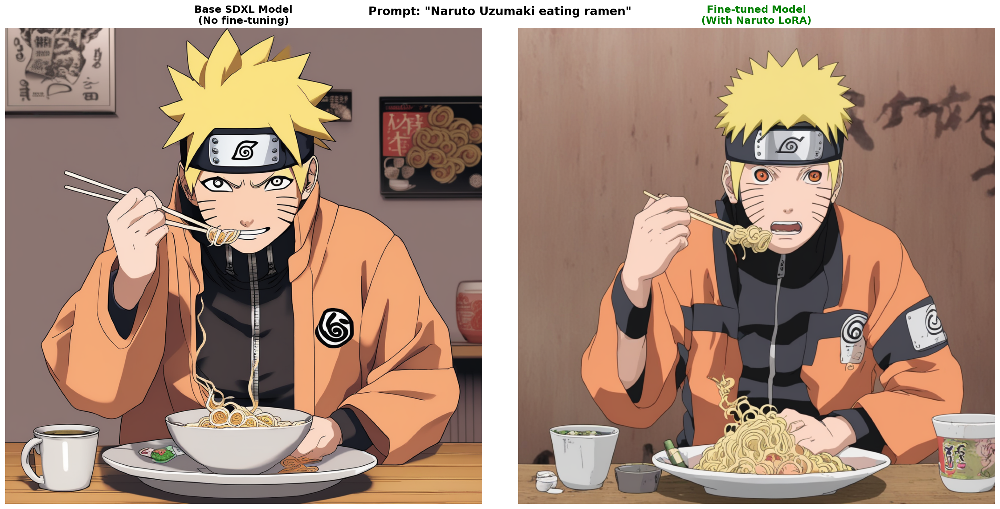


[2/3] Processing: 'Bill Gates in Naruto style'

🎨 Step 1: Generating with BASE model...

🔄 Loading base model...


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

⚠️  xFormers not available
✓ Base model loaded


  0%|          | 0/30 [00:00<?, ?it/s]

✓ Saved: /content/inference_results/base_2.png
✓ Base pipeline unloaded from memory

🎨 Step 2: Generating with FINE-TUNED model...

🔄 Loading fine-tuned model...


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading LoRA weights...
✓ Fine-tuned model loaded


  0%|          | 0/30 [00:00<?, ?it/s]

✓ Saved: /content/inference_results/finetuned_2.png
✓ Fine-tuned pipeline unloaded from memory

📊 Step 3: Creating comparison image...
✓ Saved comparison: /content/inference_results/comparison_2.png

✅ Prompt 2 completed successfully!

📸 Preview:


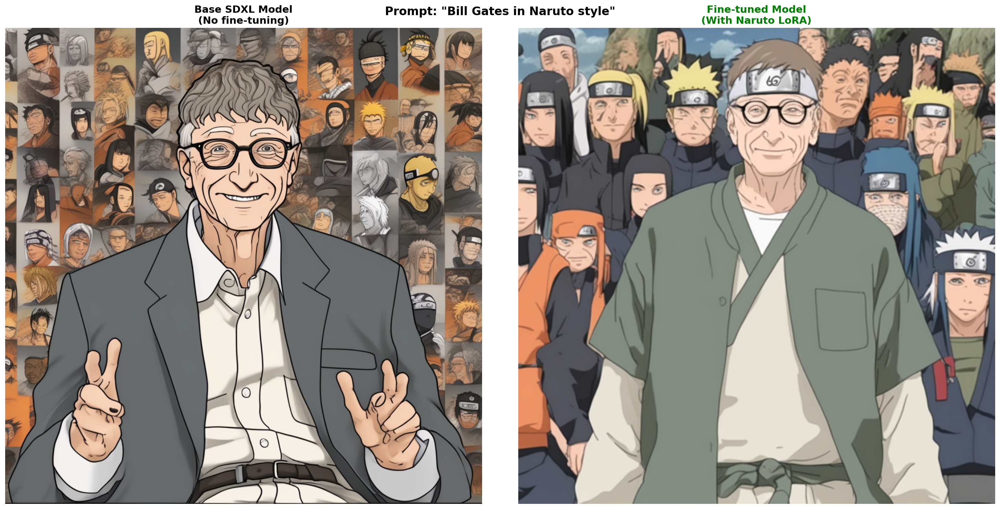


[3/3] Processing: 'A boy with blue eyes in Naruto style'

🎨 Step 1: Generating with BASE model...

🔄 Loading base model...


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

⚠️  xFormers not available
✓ Base model loaded


  0%|          | 0/30 [00:00<?, ?it/s]

✓ Saved: /content/inference_results/base_3.png
✓ Base pipeline unloaded from memory

🎨 Step 2: Generating with FINE-TUNED model...

🔄 Loading fine-tuned model...


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading LoRA weights...
✓ Fine-tuned model loaded


  0%|          | 0/30 [00:00<?, ?it/s]

✓ Saved: /content/inference_results/finetuned_3.png
✓ Fine-tuned pipeline unloaded from memory

📊 Step 3: Creating comparison image...
✓ Saved comparison: /content/inference_results/comparison_3.png

✅ Prompt 3 completed successfully!

📸 Preview:


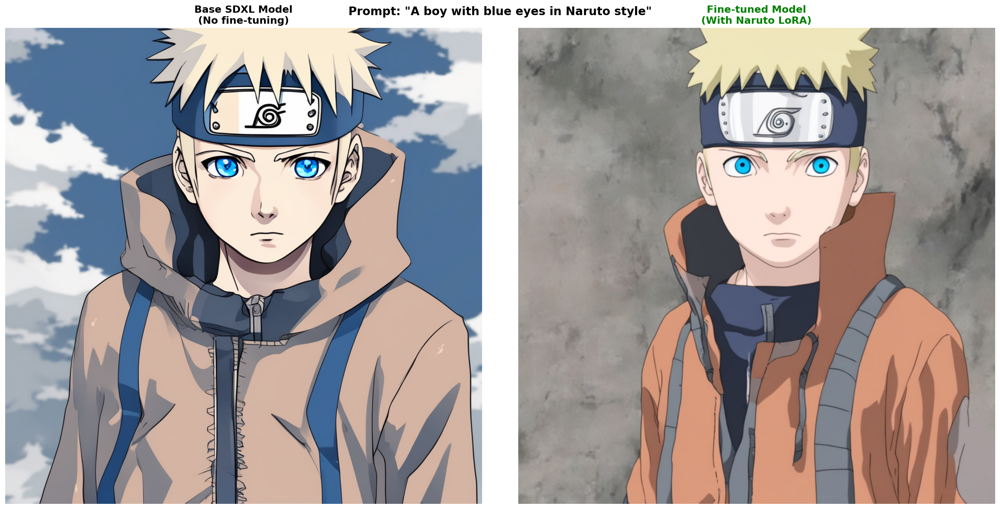


✅ ALL COMPARISONS COMPLETED!


In [ ]:
print("\n" + "="*80)
print("GENERATING COMPARISONS (Memory-Optimized)")
print("="*80)
print("\n⚠️  NOTE: We load one model at a time to save memory")
print("This takes longer but prevents OOM errors\n")

results = []

for i, prompt in enumerate(config.test_prompts):
    print(f"\n{'='*70}")
    print(f"[{i+1}/{len(config.test_prompts)}] Processing: '{prompt}'")
    print(f"{'='*70}")

    # ========== GENERATE WITH BASE MODEL ==========
    print("\n🎨 Step 1: Generating with BASE model...")

    # Load base pipeline
    base_pipeline = load_base_pipeline()

    # Generate
    base_img = generate_image(base_pipeline, prompt, seed=config.seed + i)

    # Save immediately
    base_path = os.path.join(config.output_dir, f"base_{i+1}.png")
    base_img.save(base_path)
    print(f"✓ Saved: {base_path}")

    # CRITICAL: Delete pipeline and clear memory
    del base_pipeline
    clear_memory()
    print("✓ Base pipeline unloaded from memory")

    # ========== GENERATE WITH FINE-TUNED MODEL ==========
    print("\n🎨 Step 2: Generating with FINE-TUNED model...")

    # Load fine-tuned pipeline
    finetuned_pipeline = load_finetuned_pipeline()

    # Generate
    finetuned_img = generate_image(finetuned_pipeline, prompt, seed=config.seed + i)

    # Save immediately
    finetuned_path = os.path.join(config.output_dir, f"finetuned_{i+1}.png")
    finetuned_img.save(finetuned_path)
    print(f"✓ Saved: {finetuned_path}")

    # CRITICAL: Delete pipeline and clear memory
    del finetuned_pipeline
    clear_memory()
    print("✓ Fine-tuned pipeline unloaded from memory")

    # ========== CREATE COMPARISON ==========
    print("\n📊 Step 3: Creating comparison image...")

    fig = create_comparison_grid(base_img, finetuned_img, prompt)
    comparison_path = os.path.join(config.output_dir, f"comparison_{i+1}.png")
    fig.savefig(comparison_path, dpi=150, bbox_inches='tight')
    plt.close(fig)

    print(f"✓ Saved comparison: {comparison_path}")

    # Store results
    results.append({
        'prompt': prompt,
        'base_img': base_img,
        'finetuned_img': finetuned_img
    })

    print(f"\n✅ Prompt {i+1} completed successfully!")

    # Display inline (optional - comment out if causing issues)
    print(f"\n📸 Preview:")
    display(Image.open(comparison_path))

print("\n" + "="*80)
print("✅ ALL COMPARISONS COMPLETED!")
print("="*80)

## Display All Comparisons

FINAL COMPARISON GALLERY

✓ Full gallery saved: /content/inference_results/full_comparison_gallery.png


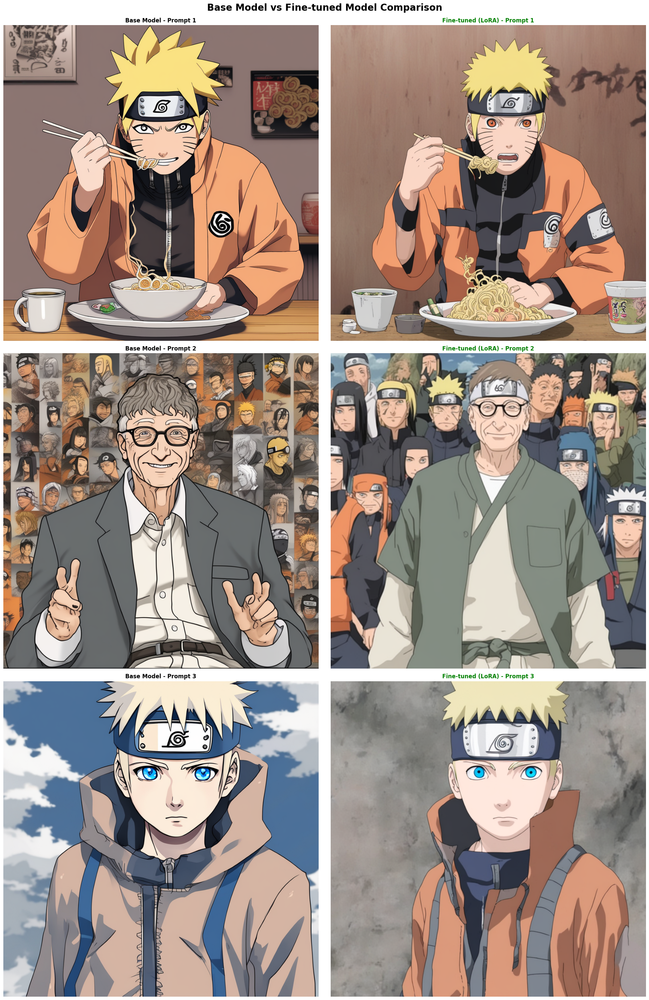

In [ ]:
print("FINAL COMPARISON GALLERY")
print("="*80)

num_prompts = len(config.test_prompts)
fig, axes = plt.subplots(num_prompts, 2, figsize=(20, 10*num_prompts))

if num_prompts == 1:
    axes = axes.reshape(1, -1)

for i, result in enumerate(results):
    # Base model
    axes[i, 0].imshow(result['base_img'])
    axes[i, 0].set_title(f"Base Model - Prompt {i+1}", fontsize=12, fontweight='bold')
    axes[i, 0].axis('off')

    # Fine-tuned model
    axes[i, 1].imshow(result['finetuned_img'])
    axes[i, 1].set_title(f"Fine-tuned (LoRA) - Prompt {i+1}", fontsize=12, fontweight='bold', color='green')
    axes[i, 1].axis('off')

plt.suptitle("Base Model vs Fine-tuned Model Comparison", fontsize=20, fontweight='bold', y=0.995)
plt.tight_layout()

# Save full gallery
gallery_path = os.path.join(config.output_dir, "full_comparison_gallery.png")
plt.savefig(gallery_path, dpi=150, bbox_inches='tight')
print(f"\n✓ Full gallery saved: {gallery_path}")

plt.show()

plt.close('all')
clear_memory()